In [1]:
mydir.D30 = "/nfs/leia/research/stegle/dseaton/hipsci/singlecell_neuroseq/data/data_processed/pool1_13_noddd_D30/qtl_analysis/eqtl_discovery/celltype_DA/summary_stats/"
res.DA.D30 = read.csv(paste0(mydir.D30,"pool1_13_noddd_D30.DA.qtl_results_all.txt"),sep="\t")

In [2]:
head(res.DA.D30,2)
head(res.DA.D30[res.DA.D30$feature_id == 'ENSG00000166086',],2)

feature_id,snp_id,p_value,beta,beta_se,empirical_feature_p_value,feature_chromosome,feature_start,feature_end,n_samples,n_e_samples,snp_chromosome,snp_position,assessed_allele,call_rate,maf,hwe_p
ENSG00000128607,7_129778518_G_T,1.090016e-08,-0.2782029,0.04867012,-1,7,129710350,129775560,165,165,7,129778518,T,1,0.4606061,0.533249
ENSG00000128607,7_129779264_T_C,1.090016e-08,-0.2782029,0.04867012,-1,7,129710350,129775560,165,165,7,129779264,C,1,0.4606061,0.533249


,feature_id,snp_id,p_value,beta,beta_se,empirical_feature_p_value,feature_chromosome,feature_start,feature_end,n_samples,n_e_samples,snp_chromosome,snp_position,assessed_allele,call_rate,maf,hwe_p
7406602,ENSG00000166086,11_133982074_C_T,1.005582e-05,-0.2108651,0.04775057,-1,11,133938820,134021896,165,165,11,133982074,T,1,0.1696970,0.1712618
7406611,ENSG00000166086,11_134235220_C_G,1.731544e-04,0.1332590,0.03548586,-1,11,133938820,134021896,165,165,11,134235220,G,1,0.3333333,0.5992988


In [3]:
mydir.D52 = "/nfs/leia/research/stegle/dseaton/hipsci/singlecell_neuroseq/data/data_processed/pool1_17_D52/qtl_analysis/eqtl_discovery_separated_by_treatment/input_files_untreated/celltype_DA/summary_stats/"
res.DA.D52 = read.csv(paste0(mydir.D52,"pool1_17_D52.DA.qtl_results_all.txt"),sep="\t")

In [28]:
annos_file = "/hps/nobackup/hipsci/scratch/singlecell_endodiff/data_processed/scQTLs/annos/combined_feature_id_annos.tsv"
annos = read.csv(annos_file,sep="\t")
head(annos)

feature_id,chromosome,start,end,hgnc_symbol,combined_feature_id,ensembl_gene_id
ENSG00000000003_TSPAN6,X,99883667,99894988,TSPAN6,ENSG00000000003_TSPAN6,ENSG00000000003
ENSG00000000419_DPM1,20,49551404,49575092,DPM1,ENSG00000000419_DPM1,ENSG00000000419
ENSG00000000457_SCYL3,1,169818772,169863408,SCYL3,ENSG00000000457_SCYL3,ENSG00000000457
ENSG00000000460_C1orf112,1,169631245,169823221,C1orf112,ENSG00000000460_C1orf112,ENSG00000000460
ENSG00000001036_FUCA2,6,143815948,143832827,FUCA2,ENSG00000001036_FUCA2,ENSG00000001036
ENSG00000001084_GCLC,6,53362139,53481768,GCLC,ENSG00000001084_GCLC,ENSG00000001084


In [5]:
leads = read.csv("/hps/nobackup/stegle/users/acuomo/all_scripts/sc_neuroseq/eqtl/all_leads_5pct_FDR_Storey.csv")
head(leads,2)

X,snp_id,p_value,beta,beta_se,empirical_feature_p_value,feature_chromosome,feature_start,feature_end,n_samples,...,snp_chromosome,snp_position,assessed_allele,call_rate,maf,hwe_p,feature_id,BH_fdr,q_value,label
2,11_107726716_A_C,4.544994e-05,0.09036565,0.02216001,0.0001665921,11,107661717,107799019,173,...,11,107726716,C,1,0.4306358,0.5386349,ENSG00000110660,0.001808781,0.00075681,FPP_D11
7,11_106001229_C_A,5.034677e-05,-0.24701335,0.06093060,0.0258019418,11,105946228,105969437,173,...,11,106001229,A,1,0.1213873,0.4744572,ENSG00000149313,0.116865230,0.04889743,FPP_D11


In [42]:
genes = as.character(leads[leads$label == "DA_D30","feature_id"])
genes0 = as.character(leads[leads$label == "DA_D52","feature_id"])
# genes
D52_genes = genes0[!(genes0 %in% genes)]

In [43]:
length(D52_genes)

[1] 441

In [44]:
# library(ggplot2)

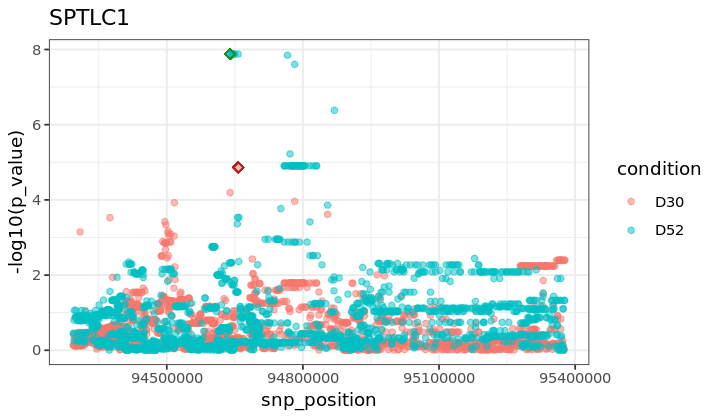

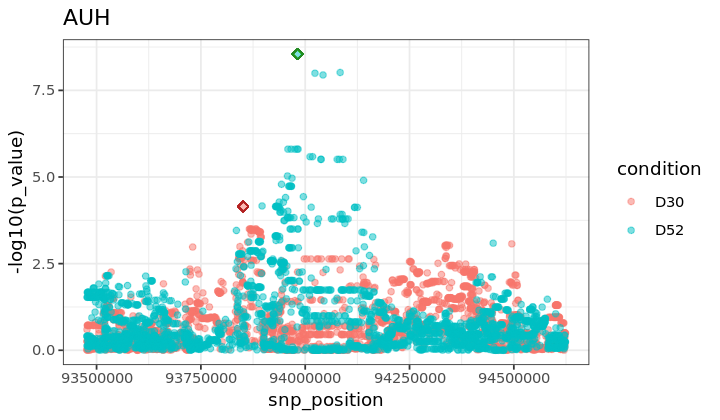

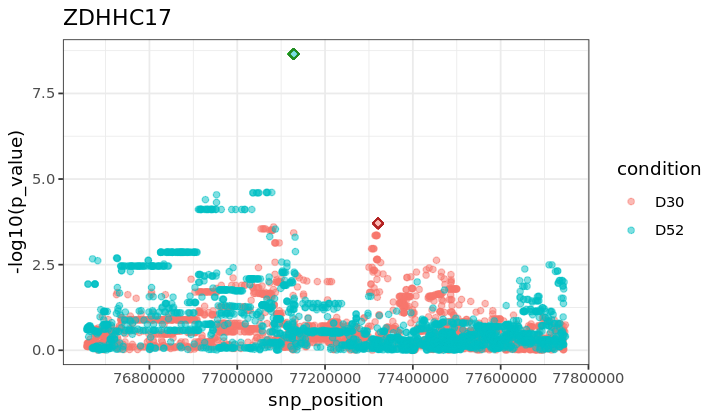

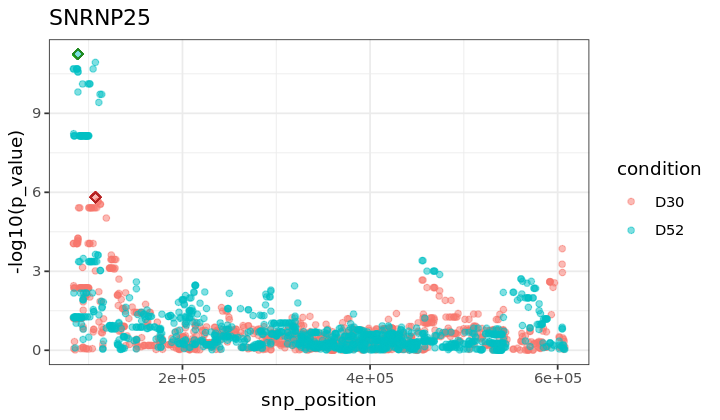

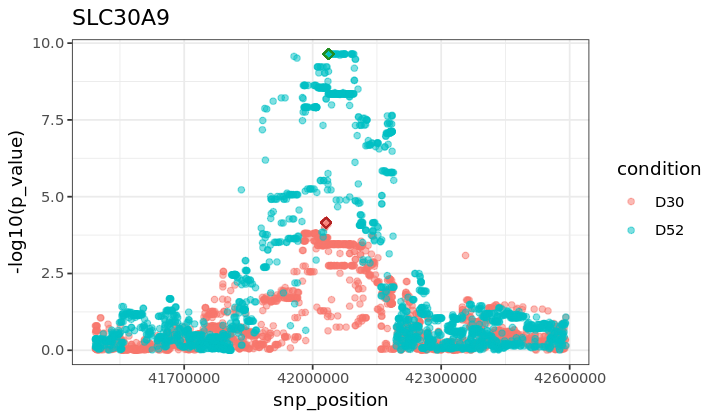

...

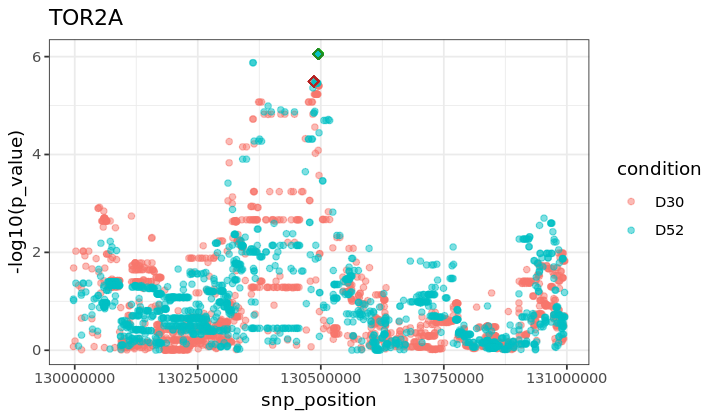

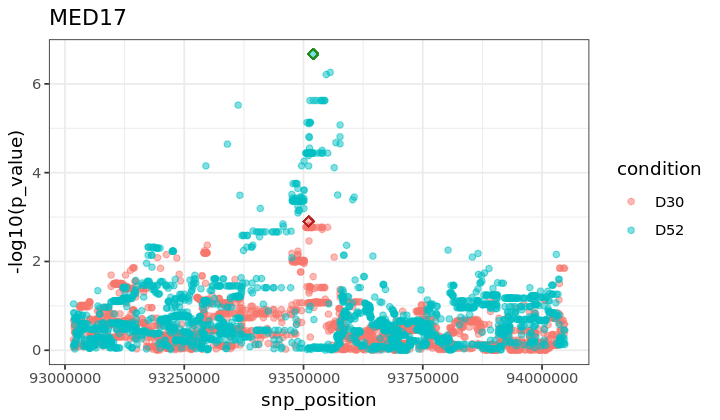

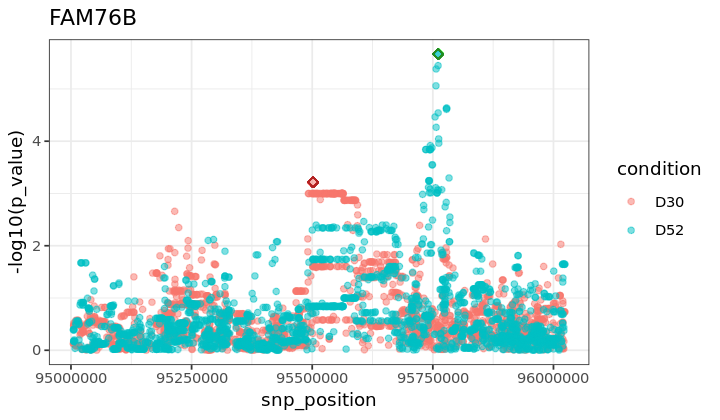

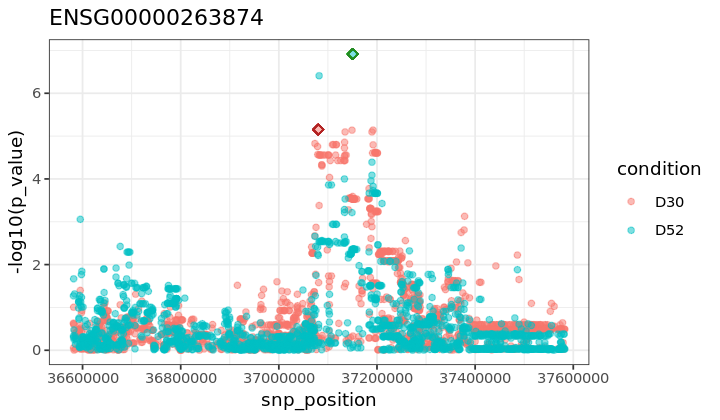

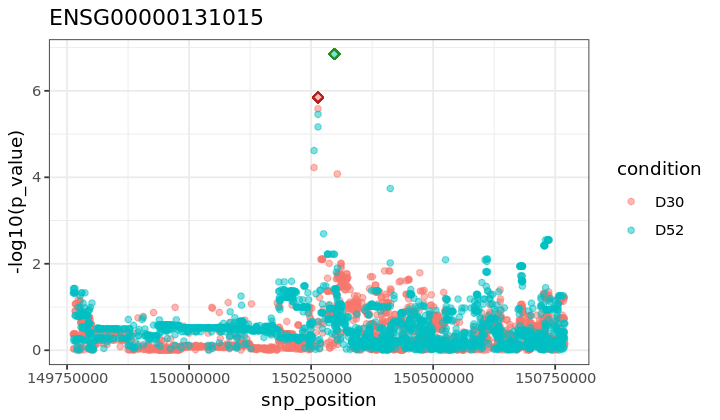

In [45]:
for (gene in D52_genes){
    gene_name = as.character(annos[annos$ensembl_gene_id == gene,"hgnc_symbol"])
    if (length(gene_name) == 0){
        gene_name = gene
    }
    r1 = res.DA.D30[res.DA.D30$feature_id == gene,]
    r2 = res.DA.D52[res.DA.D52$feature_id == gene,]
    if (nrow(r1)>0 & nrow(r2)>0){
        r1$condition = "D30"
        r2$condition = "D52"
        df = rbind(r1,r2)
        m1 = min(df[df$condition == "D30","p_value"])
        pos1 = df[df$condition == "D30" & df$p_value == m1,"snp_position"][1]
        m2 = min(df[df$condition == "D52","p_value"])
        pos2 = df[df$condition == "D52" & df$p_value == m2,"snp_position"][1]
        p = ggplot(df, aes(x = snp_position, y = -log10(p_value), colour = condition))+geom_point(alpha = 0.5)
        p = p + geom_point(aes(x=pos1, y = -log10(m1)),col="firebrick", size = 2, shape = 23, alpha = 1)
        p = p + geom_point(aes(x=pos2, y = -log10(m2)),col="forestgreen", size = 2, shape = 23, alpha = 1)
        p = p + ggtitle(gene_name) 
        p = p + ylim(c(0,-log10(min(df$p_value)))) + theme_bw()
        print(p)
    }    
}

In [30]:
library(ggthemes)

mypalette = "Warm and cool"
col_D30 = canva_pal(mypalette)(4)[3]
col_D52 = canva_pal(mypalette)(4)[1]

In [25]:
gene_name = 'HSPB1'

In [55]:
# gene_name = 'NUPL2'
# gene_name = 'WNT3'
# gene_name = 'SLC36A4'
# gene_name = 'DOCK7'

In [56]:
annos[annos$hgnc_symbol == gene_name,]
gene = as.character(annos[annos$hgnc_symbol == gene_name,"ensembl_gene_id"])

,feature_id,chromosome,start,end,hgnc_symbol,combined_feature_id,ensembl_gene_id
2560,ENSG00000108379_WNT3,17,44839872,44910520,WNT3,ENSG00000108379_WNT3,ENSG00000108379


In [57]:
leads[leads$feature_id == gene,]

,X,snp_id,p_value,beta,beta_se,empirical_feature_p_value,feature_chromosome,feature_start,feature_end,n_samples,...,snp_chromosome,snp_position,assessed_allele,call_rate,maf,hwe_p,feature_id,BH_fdr,q_value,label
21,99,17_44908263_C_T,4.554946e-08,-0.4891955,0.08946740,1.117844e-03,17,44839872,44910520,173,...,17,44908263,T,1,0.4017341,0.03938776,ENSG00000108379,9.302436e-03,3.892220e-03,FPP_D11
2870,1447,17_44908263_C_T,1.054351e-06,-0.4071956,0.08342097,4.302244e-03,17,44839872,44910520,172,...,17,44908263,T,1,0.4040698,0.03883450,ENSG00000108379,2.941258e-02,1.292652e-02,P_FPP_D11
8045,66141,17_44891301_C_T,9.949884e-10,-0.5934662,0.09712695,5.448295e-05,17,44839872,44910520,133,...,17,44891301,T,1,0.4962406,0.22763201,ENSG00000108379,1.791214e-03,9.500791e-04,Epen1_D30
8593,4724,17_44908263_C_T,2.751040e-21,-0.8535476,0.09011476,3.032062e-12,17,44839872,44910520,175,...,17,44908263,T,1,0.4285714,0.12603232,ENSG00000108379,4.497933e-10,2.646494e-10,DA_D52
12738,2026,17_44908263_C_T,4.085619e-15,-0.7177515,0.09140684,1.344710e-07,17,44839872,44910520,157,...,17,44908263,T,1,0.4299363,0.25380419,ENSG00000108379,1.756308e-05,1.191644e-05,DA_D52_ROT


In [32]:
r1 = res.DA.D30[res.DA.D30$feature_id == gene,]
r2 = res.DA.D52[res.DA.D52$feature_id == gene,]

In [33]:
m1 = min(r1$p_value)
m2 = min(r2$p_value)
m = min(m1,m2)

In [34]:
options(repr.plot.width = 6, repr.plot.height = 3.5)

In [35]:
library(ggplot2)

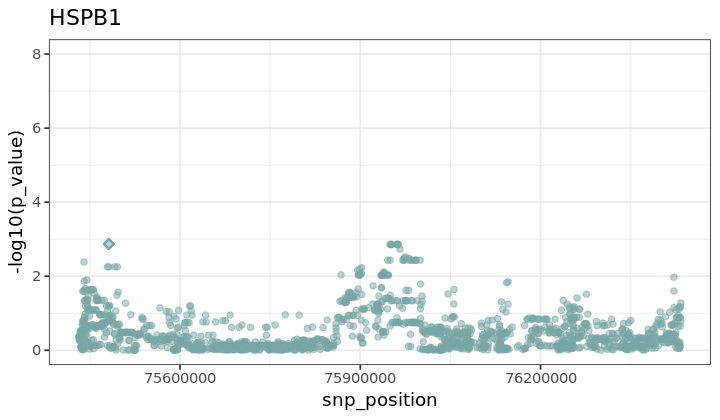

In [36]:
pos1 = r1[r1$p_value == m1,"snp_position"][1]
ggplot(r1, aes(x = snp_position, y = -log10(p_value))) + geom_point(alpha = 0.5,col=col_D30) + 
    geom_point(aes(x=pos1, y = -log10(m1)),col=col_D30, size = 2, shape = 23, alpha = 1) + 
    ggtitle(gene_name) + ylim(c(0,8)) + theme_bw()

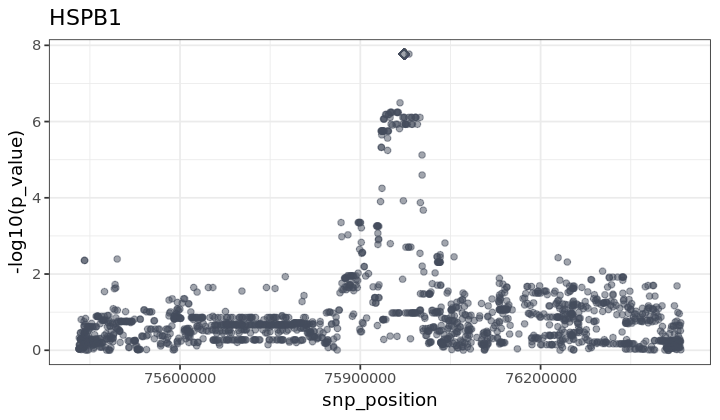

In [37]:
pos2 = r2[r2$p_value == m2,"snp_position"][1]
ggplot(r2, aes(x = snp_position, y = -log10(p_value))) + geom_point(alpha = 0.5,col=col_D52) + 
    geom_point(aes(x=pos2, y = -log10(m2)),col=col_D52, size = 2, shape = 23, alpha = 1) + 
    ggtitle(gene_name) + ylim(c(0,-log10(m))) + theme_bw()